In [ ]:
##ACTIVATION LAYERS##

1/1 [==============================] - 3s 3s/step


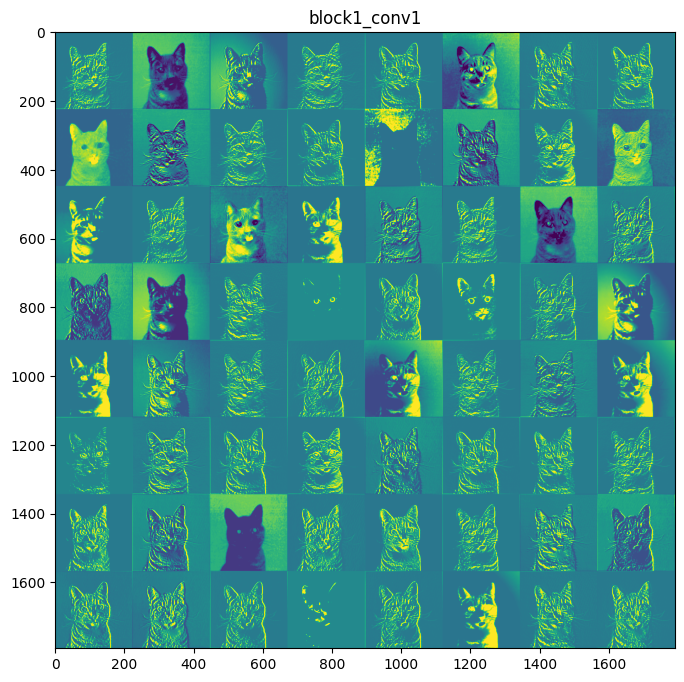

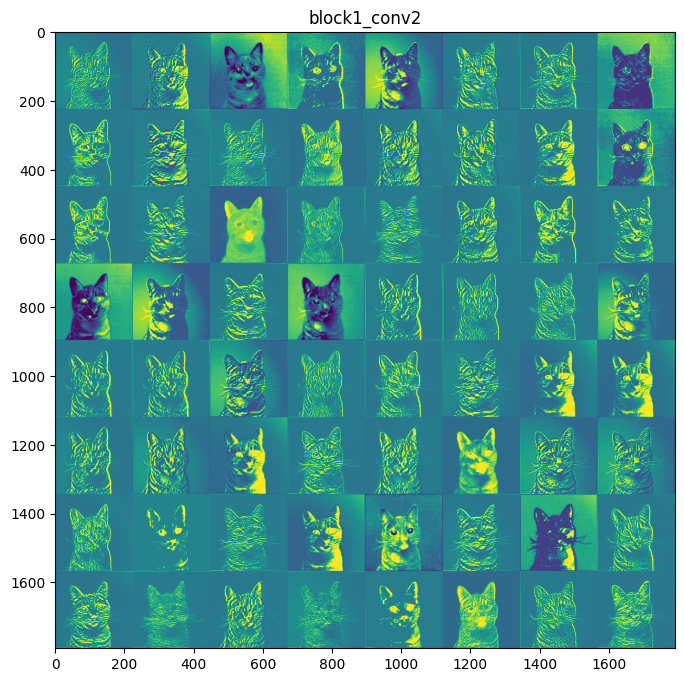

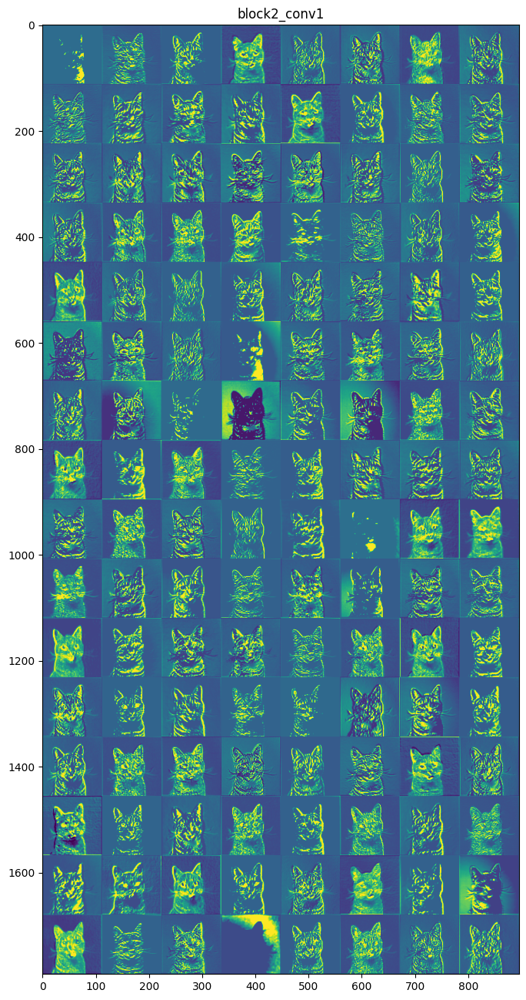

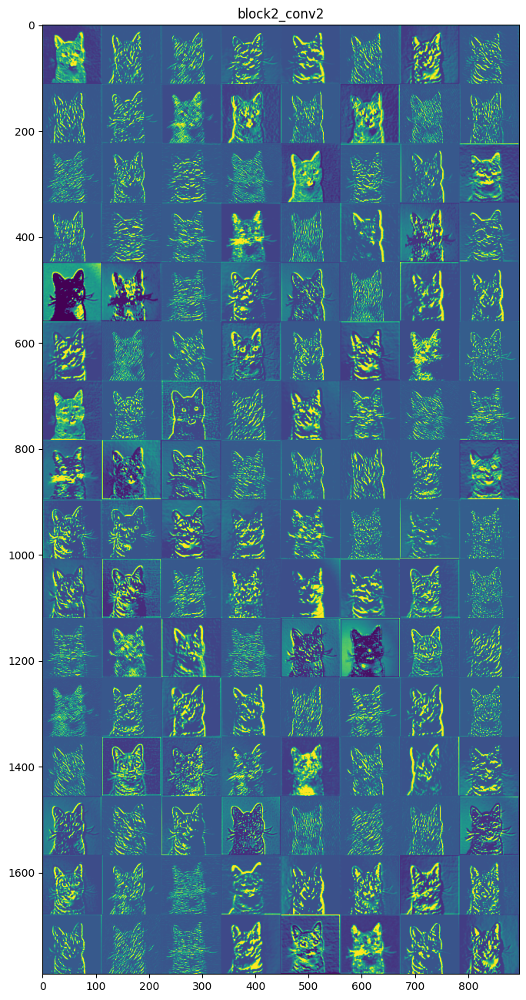

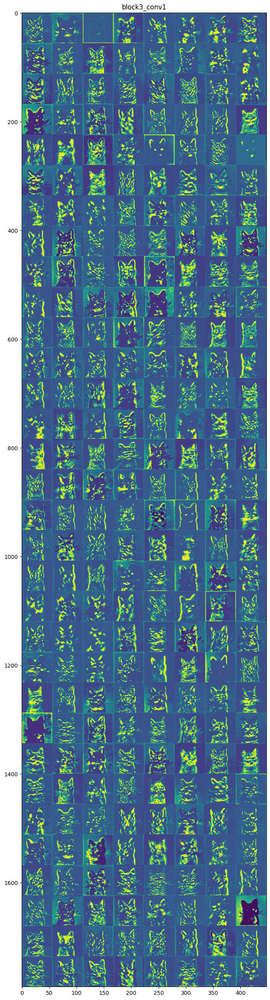

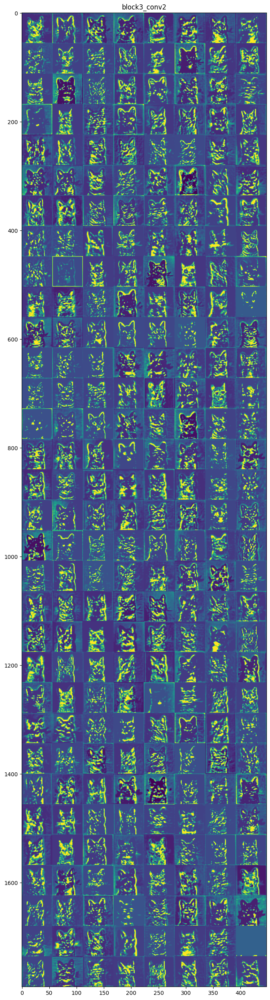

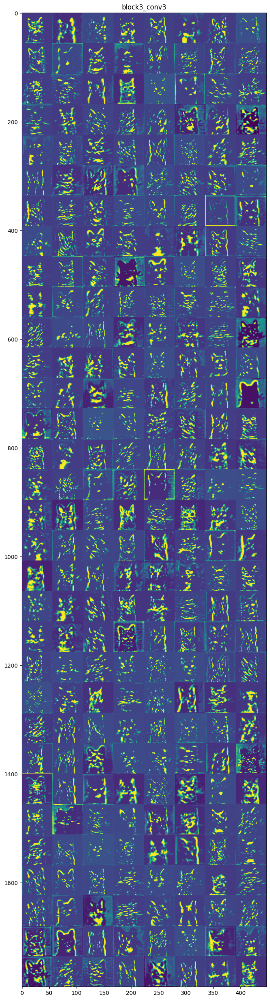

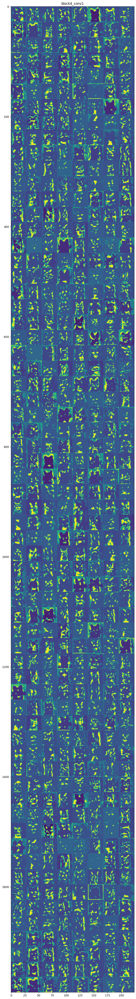

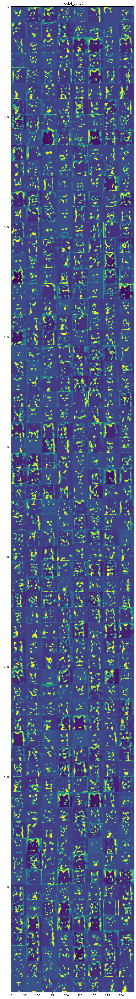

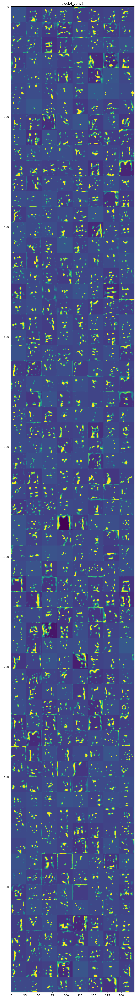

<ipython-input-1-7161089c70c6>:44: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std()


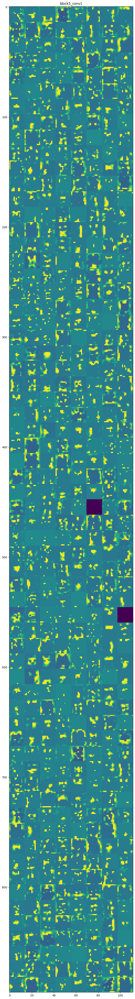

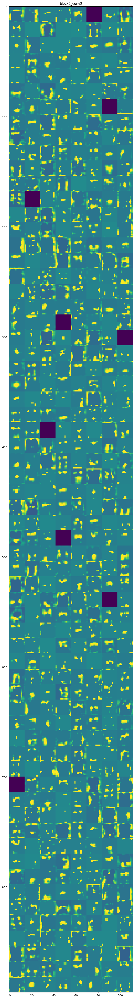

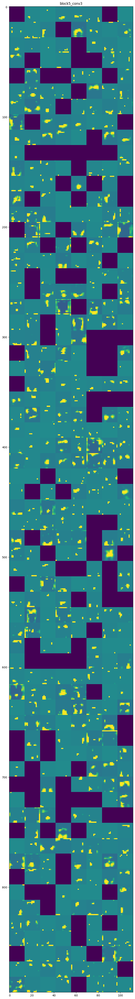

In [1]:
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO

# Load the pre-trained VGG16 model
model = VGG16(weights='imagenet')

# Create a new model that outputs the activation maps of all the convolutional layers
layer_names = []
for layer in model.layers:
    if 'conv' in layer.name:
        layer_names.append(layer.name)
        
layer_outputs = [model.get_layer(name).output for name in layer_names]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

url = 'https://api.time.com/wp-content/uploads/2014/11/140372563.jpg'
response = requests.get(url)
img = Image.open(BytesIO(response.content))
img = img.resize((224, 224))

# Preprocess the image
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

# Get the activation maps for the example image
activations = activation_model.predict(x)

for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]  # Number of features in the feature map
    size = layer_activation.shape[1]  # The feature map has shape (1, size, size, n_features)
    n_cols = n_features // 8  # Tiles the activation channels in this matrix
    display_grid = np.zeros((size * n_cols, 8 * size))
    for col in range(n_cols):  # Tiles each filter into a big horizontal grid
        for row in range(8):
            channel_image = layer_activation[0, :, :, col * 8 + row]
            channel_image -= channel_image.mean()  # Post-processes the feature to make it visually palatable
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    plt.show()

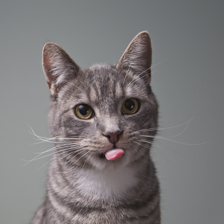

In [2]:
img.show()

In [ ]:
##FILTERS##

58889256/58889256 [==============================] - 0s 0us/step


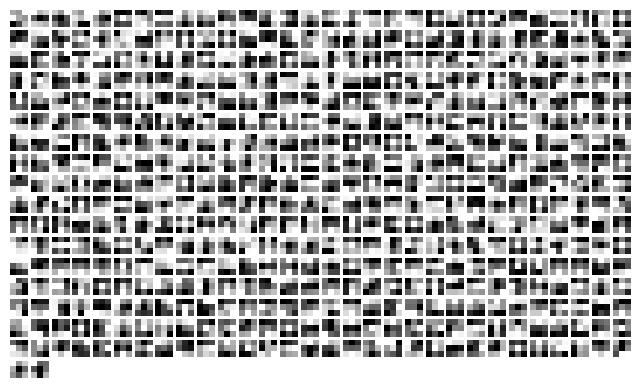

In [3]:
from keras.applications.vgg16 import VGG16

model = VGG16(weights='imagenet', include_top=False)

def plot_filters(model, layer_name):
    layer = model.get_layer(name=layer_name)
    filters, biases = layer.get_weights()
    num_filters = filters.shape[3]
    plt.figure(figsize=(8, 8))
    for i in range(num_filters):
        f = filters[:, :, :, i]
        plt.subplot(30, 30, i+1)
        plt.imshow(f[:, :, 0], cmap='gray')
        plt.axis('off')
    plt.show()

plot_filters(model, 'block5_conv1')


In [9]:
import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16
import numpy as np
import matplotlib.pyplot as plt

# Load the VGG16 model
model = VGG16()

# Define the input image
input_image = tf.Variable(np.zeros((1, 224, 224, 3)), dtype=tf.float32)

# Define the index of the class to maximize
class_index = 0

# Define the loss function as the mean of the predicted class output
@tf.function
def loss_fn():
    output = model(input_image)
    loss = -tf.reduce_mean(output[:, class_index])
    return loss

# Define the optimizer and learning rate
optimizer = tf.optimizers.Adam(learning_rate=0.01)

# Define the number of frames to save
num_frames = 10

# Perform gradient ascent for 1000 steps
for i in range(50):
    # Compute the loss and gradients
    with tf.GradientTape() as tape:
        loss = loss_fn()
    grads = tape.gradient(loss, input_image)

    # Normalize the gradients
    grads /= tf.sqrt(tf.reduce_mean(tf.square(grads))) + 1e-5

    # Update the input image
    optimizer.apply_gradients([(grads, input_image)])
    input_image.assign(tf.clip_by_value(input_image, 0, 1))

    # Save the output frames
    if i % (50 // num_frames) == 0:
        output_image = input_image.numpy()[0]
        output_image = (output_image - output_image.min()) / (output_image.max() - output_image.min())
        plt.imshow(output_image)
        plt.axis("off")
        plt.savefig(f"output_{i}.png")
        plt.close()

# Print the final input image
final_image = input_image.numpy()[0]
final_image = (final_image - final_image.min()) / (final_image.max() - final_image.min())
plt.imshow(final_image)
plt.axis("off")
plt.savefig("final_output.png")
plt.close()
